# Twitter Fat talk data analysis [Tweets from December 2020 and Jan, Feb 2021]

## Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
import nltk
import string
import re

## Load tweets from the csv file

In [2]:
def LoadTweetFile():
    data = pd.read_csv(r"D:\Dropbox (ASU)\JBVV2Z2_Backup\Project.Others\Project.FatTalk\Data\Tweets_Dec2020_Jan2021.csv")
    return data

In [3]:
tweetDf = LoadTweetFile()
tweetDf.head(20)

,tweetid,userid,username,acctdesc,location,following,followers,totaltweets,usercreatedts,retweetcount,hashtags,source,source_url,retweeted,text,created_at
0,1341794359071690752,585689445,MsJenniferG,"If we winter this one out, we can summer anywh...",NaN,50,119,6906,2012-05-20 11:54:10,0,[],Twitter for Android,http://twitter.com/download/android,False,I'm wearing a pair of really tight (vegan) lea...,2020-12-23 17:14:39
1,1342144756894162944,1162882585359351808,Iamfat_Faroon,最多6003 所属してる軍団➡️My crew ファルチェバルーン使ってます！\nイ...,冷蔵庫の裏,462,457,6098,2019-08-18 00:23:22,0,[],Twitter Web App,https://mobile.twitter.com,False,@fenofinalform03 Oh no,2020-12-24 16:27:00
2,1342175221558648833,1305907944190406656,RimaSultana694,#digitalmarketing #onlinemarketing #onlineshop...,USA,271,325,340,2020-09-15 16:35:29,1,"[{'text': 'weighted', 'indices': [96, 105]}, {...",Twitter Web App,https://mobile.twitter.com,False,CHRISTMAS OFFER. For more details CLICK THIS L...,2020-12-24 18:28:03
3,1342175388026490880,496553743,Drsheywood,40K VIP Leader focused on sharing the importan...,"Fort Lauderdale, Florida",242,238,2211,2012-02-19 02:38:21,0,"[{'text': 'thrivelife', 'indices': [176, 187]}...",Twitter for iPhone,http://twitter.com/download/iphone,False,Today is the last day to claim your free acces...,2020-12-24 18:28:43
4,1342175535904948224,1019334779114672128,DewHealthy,Promoting #NaturalHealth #PainRelief #CBD #Pla...,"Mesa, AZ",5307,4858,20434,2018-07-17 21:35:24,64,[],Twitter Web App,https://mobile.twitter.com,False,Want to Burn More Belly Fat? Give strength tr...,2020-12-24 18:29:18
5,1342175733746163712,1110561512916045825,KetoWeightLossE,🔥Burn 30 Pounds in Just 30 Days...Risk Free💯\n...,USA,621,83,265,2019-03-26 15:17:52,0,"[{'text': 'weightloss', 'indices': [109, 120]}...",IFTTT,https://ifttt.com,False,The only relief from chronic pain and celiac I...,2020-12-24 18:30:06
6,1342175747566350343,1255526183552184320,KlsWellness,NaN,NaN,10,8,23,2020-04-29 15:56:01,0,"[{'text': 'strongisbeautiful', 'indices': [79,...",Hootsuite Inc.,https://www.hootsuite.com,False,"Wishing you strength, resilience, and beauty ...",2020-12-24 18:30:09
7,1342175769951424515,931581669001199616,FamilyHealth9,Provide health information and tips for people...,NaN,12,178,8137,2017-11-17 17:55:52,1,"[{'text': 'tagfire', 'indices': [103, 111]}, {...",Crowdfire App,https://crowdfireapp.com,False,Protect Your Eyesight And Keep Your Eyes Healt...,2020-12-24 18:30:14
8,1342175944899964928,1271865233678557184,Keto101Diet,I help people like you to lose weight without ...,NaN,54,119,427,2020-06-13 18:02:07,0,"[{'text': 'keto', 'indices': [68, 73]}, {'text...","Cheap Bots, Done Quick!",https://cheapbotsdonequick.com,False,Avocado Keto diet recipes &gt;&gt; https://t.c...,2020-12-24 18:30:56
9,1342176026571329537,14912886,BoBabenko,FitCare Physiotherapy & Wellness offers online...,"Dana Point, CA",447,485,2331,2008-05-26 20:26:14,0,"[{'text': 'fitness', 'indices': [161, 169]}, {...",Twitter for iPhone,http://twitter.com/download/iphone,False,Want stronger shoulders? Or a better six pack....,2020-12-24 18:31:15


## adding userid and tweet in df for further processing

,userid,text
0,585689445,I'm wearing a pair of really tight (vegan) lea...
1,1162882585359351808,@fenofinalform03 Oh no


## Seperate Hashtags and Mentions

,userid,text,hashtags,mentions
0,585689445,I'm wearing a pair of really tight (vegan) lea...,[],[]
1,1162882585359351808,@fenofinalform03 Oh no,[],[@fenofinalform03]


## WordCloud for raw data

(-0.5, 399.5, 199.5, -0.5)

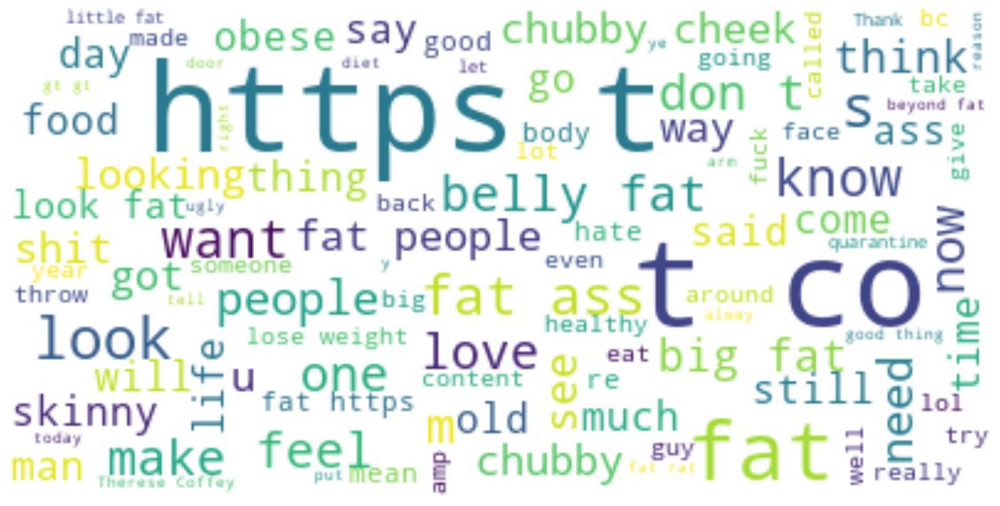

## Clean tweet (removing emoji, mention, smiley, number, etc.)

,userid,text,hashtags,mentions,tweet,tweet_NoHASH
0,585689445,I'm wearing a pair of really tight (vegan) lea...,[],[],im wearing a pair of really tight vegan leathe...,im wearing a pair of really tight vegan leathe...
1,1162882585359351808,@fenofinalform03 Oh no,[],[@fenofinalform03],oh no,oh no


## Remove one and two character words

,userid,text,hashtags,mentions,tweet,tweet_NoHASH,cleaned_tweet,cleaned_tweet_NoHASH
0,585689445,I'm wearing a pair of really tight (vegan) lea...,[],[],im wearing a pair of really tight vegan leathe...,im wearing a pair of really tight vegan leathe...,wearing pair really tight vegan leather trous...,wearing pair really tight vegan leather trous...
1,1162882585359351808,@fenofinalform03 Oh no,[],[@fenofinalform03],oh no,oh no,,


## WordCloud for cleaned words

(-0.5, 399.5, 199.5, -0.5)

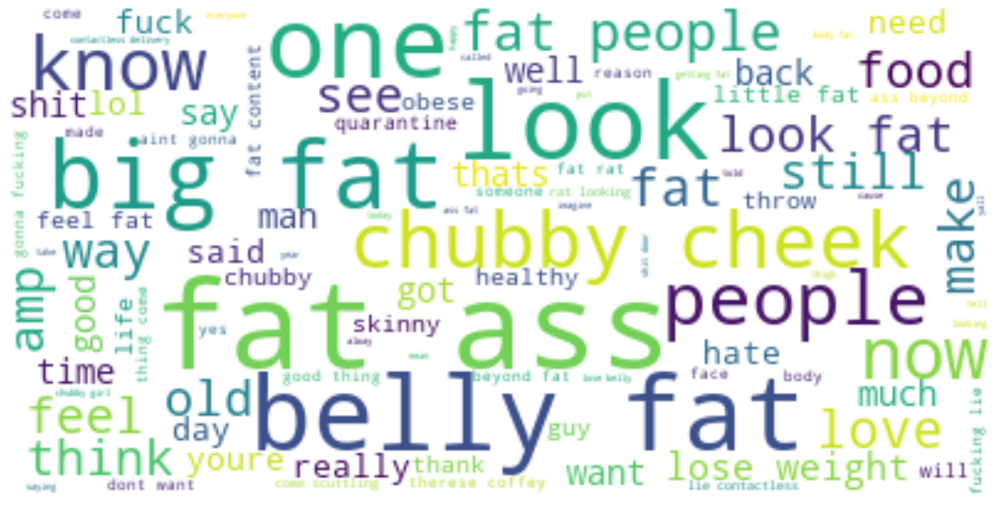

## Tokenize the words

,userid,text,hashtags,mentions,tweet,tweet_NoHASH,cleaned_tweet,cleaned_tweet_NoHASH,tweet_tokenized,tweet_tokenized_NoHASH
0,585689445,I'm wearing a pair of really tight (vegan) lea...,[],[],im wearing a pair of really tight vegan leathe...,im wearing a pair of really tight vegan leathe...,wearing pair really tight vegan leather trous...,wearing pair really tight vegan leather trous...,"[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe..."
1,1162882585359351808,@fenofinalform03 Oh no,[],[@fenofinalform03],oh no,oh no,,,[],[]
2,1305907944190406656,CHRISTMAS OFFER. For more details CLICK THIS L...,"[#weighted, #weightloss, #weight, #weight, #we...",[],christmas offer for more details click this li...,christmas offer for more details click this li...,christmas offer for more details click this li...,christmas offer for more details click this li...,"[christmas, offer, for, more, details, click, ...","[christmas, offer, for, more, details, click, ..."


## Remove stopwords

,userid,text,hashtags,mentions,tweet,tweet_NoHASH,cleaned_tweet,cleaned_tweet_NoHASH,tweet_tokenized,tweet_tokenized_NoHASH,tweet_nonstop,tweet_nonstop_NoHASH
0,585689445,I'm wearing a pair of really tight (vegan) lea...,[],[],im wearing a pair of really tight vegan leathe...,im wearing a pair of really tight vegan leathe...,wearing pair really tight vegan leather trous...,wearing pair really tight vegan leather trous...,"[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe..."
1,1162882585359351808,@fenofinalform03 Oh no,[],[@fenofinalform03],oh no,oh no,,,[],[],[],[]
2,1305907944190406656,CHRISTMAS OFFER. For more details CLICK THIS L...,"[#weighted, #weightloss, #weight, #weight, #we...",[],christmas offer for more details click this li...,christmas offer for more details click this li...,christmas offer for more details click this li...,christmas offer for more details click this li...,"[christmas, offer, for, more, details, click, ...","[christmas, offer, for, more, details, click, ...","[christmas, offer, details, weighted, blanket,...","[christmas, offer, details, blanket, loss, los..."


## Lemmatized words with POS tagging

,userid,text,hashtags,mentions,tweet,tweet_NoHASH,cleaned_tweet,cleaned_tweet_NoHASH,tweet_tokenized,tweet_tokenized_NoHASH,tweet_nonstop,tweet_nonstop_NoHASH,tweet_lemmatized,tweet_lemmatized_NoHASH
0,585689445,I'm wearing a pair of really tight (vegan) lea...,[],[],im wearing a pair of really tight vegan leathe...,im wearing a pair of really tight vegan leathe...,wearing pair really tight vegan leather trous...,wearing pair really tight vegan leather trous...,"[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe...","[, wear, pair, really, tight, vegan, leather, ...","[, wear, pair, really, tight, vegan, leather, ..."
1,1162882585359351808,@fenofinalform03 Oh no,[],[@fenofinalform03],oh no,oh no,,,[],[],[],[],[],[]
2,1305907944190406656,CHRISTMAS OFFER. For more details CLICK THIS L...,"[#weighted, #weightloss, #weight, #weight, #we...",[],christmas offer for more details click this li...,christmas offer for more details click this li...,christmas offer for more details click this li...,christmas offer for more details click this li...,"[christmas, offer, for, more, details, click, ...","[christmas, offer, for, more, details, click, ...","[christmas, offer, details, weighted, blanket,...","[christmas, offer, details, blanket, loss, los...","[christmas, offer, detail, weight, blanket, we...","[christmas, offer, detail, blanket, loss, loss..."


,userid,text,hashtags,mentions,tweet,tweet_NoHASH,cleaned_tweet,cleaned_tweet_NoHASH,tweet_tokenized,tweet_tokenized_NoHASH,tweet_nonstop,tweet_nonstop_NoHASH,tweet_lemmatized,tweet_lemmatized_NoHASH,tweet_lemm_joined,tweet_lemm_joined_NoHASH
0,585689445,I'm wearing a pair of really tight (vegan) lea...,[],[],im wearing a pair of really tight vegan leathe...,im wearing a pair of really tight vegan leathe...,wearing pair really tight vegan leather trous...,wearing pair really tight vegan leather trous...,"[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe...","[, wearing, pair, really, tight, vegan, leathe...","[, wear, pair, really, tight, vegan, leather, ...","[, wear, pair, really, tight, vegan, leather, ...",wear pair really tight vegan leather trouser ...,wear pair really tight vegan leather trouser ...
1,1162882585359351808,@fenofinalform03 Oh no,[],[@fenofinalform03],oh no,oh no,,,[],[],[],[],[],[],,
2,1305907944190406656,CHRISTMAS OFFER. For more details CLICK THIS L...,"[#weighted, #weightloss, #weight, #weight, #we...",[],christmas offer for more details click this li...,christmas offer for more details click this li...,christmas offer for more details click this li...,christmas offer for more details click this li...,"[christmas, offer, for, more, details, click, ...","[christmas, offer, for, more, details, click, ...","[christmas, offer, details, weighted, blanket,...","[christmas, offer, details, blanket, loss, los...","[christmas, offer, detail, weight, blanket, we...","[christmas, offer, detail, blanket, loss, loss...",christmas offer detail weight blanket weightlo...,christmas offer detail blanket loss loss calcu...


## WordCloud for Lemmatized Words

(-0.5, 399.5, 199.5, -0.5)

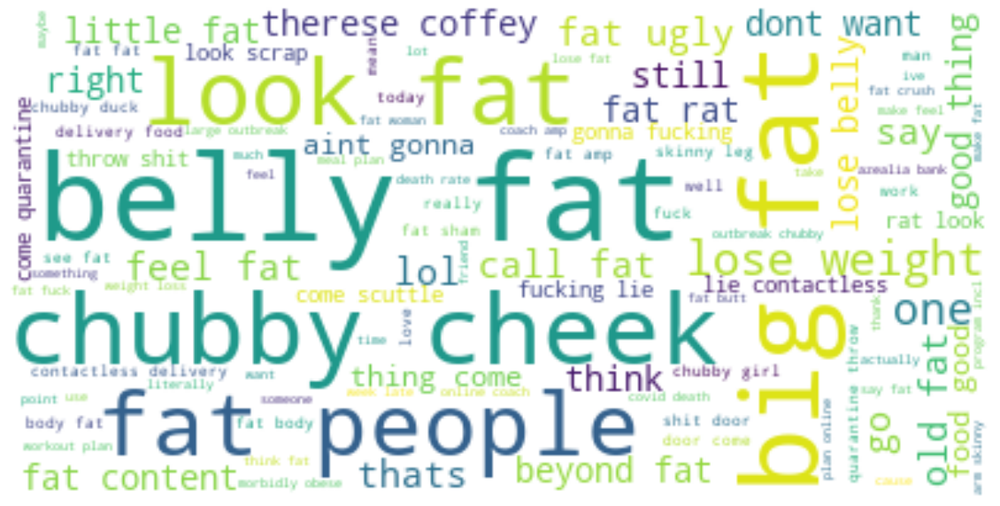

(-0.5, 399.5, 199.5, -0.5)

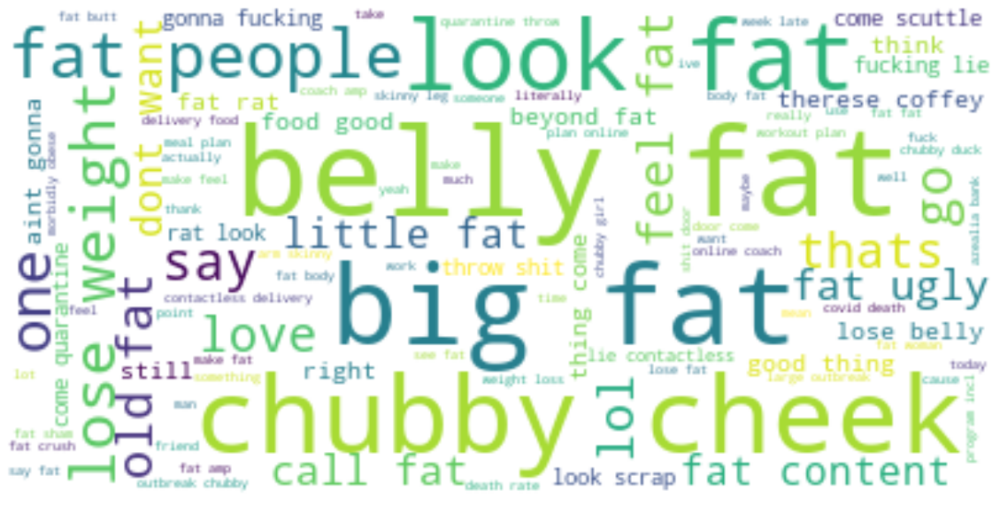

## Topic Modeling (LDA): sklearn

LatentDirichletAllocation(random_state=0)

,Topic 0 words,Topic 1 words,Topic 2 words,Topic 3 words,Topic 4 words,Topic 5 words,Topic 6 words,Topic 7 words,Topic 8 words,Topic 9 words
0,fat,fat,fat,fat,fat,skinny,people,fat,chubby,lose
1,belly,as,like,get,weight,leg,fat,like,cheek,fat
2,know,big,girl,dont,belly,around,well,look,love,amp
3,big,thigh,skinny,people,lose,fat,unhealthy,feel,fat,plan
4,men,get,chubby,make,old,death,amp,get,cute,chubby
5,wrong,butt,guy,body,content,body,life,say,baby,belly
6,hot,need,shes,take,as,chubby,health,come,draw,weight
7,week,make,arm,one,diet,one,house,shit,girl,young
8,late,stop,pretty,time,loss,give,back,good,little,video
9,dog,look,call,feel,weightloss,know,understand,fucking,face,would


,Topic 0 words,Topic 1 words,Topic 2 words,Topic 3 words,Topic 4 words,Topic 5 words,Topic 6 words,Topic 7 words,Topic 8 words,Topic 9 words
0,fat,come,fat,fat,fat,fat,skinny,chubby,fat,fat
1,get,fat,lose,as,people,death,fat,cheek,look,look
2,big,little,weight,get,like,chubby,like,love,like,like
3,belly,gonna,amp,look,make,see,leg,cute,one,dont
4,year,fucking,belly,like,dont,around,arm,baby,know,body
5,make,shit,look,bitch,say,belly,think,large,dont,youre
6,day,lie,plan,thigh,feel,old,hate,duck,want,say
7,amp,door,well,butt,eat,tribe,obese,outbreak,guy,even
8,body,aint,would,content,get,men,young,video,face,people
9,feel,good,feel,beyond,try,high,girl,amp,man,think


## Topic Modeling (LDA): Gensim 

C:\Users\bkarna\Anaconda3\envs\nlp\lib\site-packages\gensim\similarities\__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


## Gensim LDA Model Output With HashTag

[(0,
  '0.243*"shape" + 0.110*"covid" + 0.106*"sure" + 0.099*"stay" + 0.071*"walk" '
  '+ 0.064*"message" + 0.032*"protein" + 0.011*"join" + 0.004*"covid19" + '
  '0.000*"people"'),
 (1,
  '0.444*"come" + 0.150*"belly" + 0.068*"obese" + 0.058*"much" + 0.049*"need" '
  '+ 0.042*"give" + 0.041*"try" + 0.015*"post" + 0.014*"great" + 0.012*"wont"'),
 (2,
  '0.513*"think" + 0.057*"commission" + 0.043*"far" + 0.039*"whats" + '
  '0.017*"double" + 0.017*"brother" + 0.014*"sister" + 0.009*"offer" + '
  '0.009*"detail" + 0.007*"sandwich"'),
 (3,
  '0.930*"" + 0.022*"size" + 0.000*"people" + 0.000*"fucking" + 0.000*"shit" + '
  '0.000*"little" + 0.000*"lie" + 0.000*"aint" + 0.000*"throw" + '
  '0.000*"quarantine"'),
 (4,
  '0.119*"still" + 0.092*"could" + 0.079*"lol" + 0.079*"care" + 0.072*"check" '
  '+ 0.064*"obesity" + 0.051*"actually" + 0.047*"best" + 0.031*"hot" + '
  '0.029*"another"'),
 (5,
  '0.561*"know" + 0.105*"boy" + 0.046*"style" + 0.019*"model" + '
  '0.011*"fashion" + 0.011*"male"

## Gensim LDA Model Output With No HashTag

[(0,
  '0.164*"lot" + 0.117*"post" + 0.112*"instagram" + 0.088*"share" + '
  '0.075*"message" + 0.074*"top" + 0.034*"drive" + 0.019*"surprise" + '
  '0.016*"awesome" + 0.015*"currently"'),
 (1,
  '0.679*"come" + 0.085*"well" + 0.039*"high" + 0.030*"waist" + 0.029*"wish" + '
  '0.027*"watch" + 0.024*"sure" + 0.022*"stay" + 0.007*"season" + '
  '0.003*"strength"'),
 (2,
  '0.305*"love" + 0.098*"long" + 0.088*"gain" + 0.077*"week" + 0.076*"real" + '
  '0.045*"reason" + 0.036*"weigh" + 0.035*"finally" + 0.031*"eye" + '
  '0.026*"month"'),
 (3,
  '0.482*"gonna" + 0.100*"even" + 0.094*"ive" + 0.041*"nothing" + '
  '0.031*"short" + 0.031*"page" + 0.023*"mouth" + 0.021*"hear" + 0.021*"free" '
  '+ 0.020*"lb"'),
 (4,
  '0.428*"look" + 0.146*"body" + 0.129*"make" + 0.051*"never" + '
  '0.037*"healthy" + 0.023*"around" + 0.018*"diet" + 0.017*"add" + '
  '0.014*"heart" + 0.014*"last"'),
 (5,
  '0.477*"good" + 0.133*"think" + 0.086*"year" + 0.085*"new" + 0.040*"change" '
  '+ 0.033*"start" + 0.033*

## Top Unigrams raw tweets

,unigram,count
0,fat,139487
1,https,79639
2,chubby,37504
3,like,30539
4,people,19893
5,just,19488
6,look,19083
7,ass,17399
8,don,13266
9,amp,12545


## Top Unigrams Part Of Speech tagged Lemmatized tweets

,unigram,count
0,fat,139693
1,chubby,36815
2,like,31567
3,look,26793
4,people,19947
5,make,14822
6,dont,14550
7,feel,13403
8,say,13335
9,belly,12480


In [37]:
unigram_NoHASH

,unigram_NoHASH,count
0,fat,138085
1,chubby,35963
2,like,31380
3,look,26791
4,people,19938
5,make,14820
6,dont,14549
7,feel,13400
8,say,13334
9,amp,12294


## Top Bigrams Part Of Speech tagged Lemmatized tweets

,bigram,count
0,belly fat,6670
1,big fat,5393
2,chubby cheek,5335
3,look fat,4554
4,look like,4345
5,fat people,4256
6,lose weight,4034
7,feel like,3018
8,like fat,2568
9,feel fat,2295


In [39]:
bigram_NoHASH

,bigram_NoHASH,count
0,belly fat,6624
1,big fat,5384
2,chubby cheek,5313
3,look fat,4551
4,look like,4349
5,fat people,4246
6,lose weight,4009
7,feel like,3018
8,like fat,2552
9,feel fat,2285


## Top Trigrams Part Of Speech tagged Lemmatized tweets

,trigram,count
0,lose belly fat,1878
1,like little fat,1707
2,good thing come,1702
3,come scuttle like,1699
4,scuttle like little,1699
5,little fat rat,1699
6,fat rat look,1699
7,rat look scrap,1699
8,aint gonna fucking,1698
9,gonna fucking lie,1698


In [41]:
trigram_NoHASH

,trigram_NoHASH,count
0,lose belly fat,1877
1,like little fat,1707
2,good thing come,1702
3,come scuttle like,1699
4,scuttle like little,1699
5,little fat rat,1699
6,fat rat look,1699
7,rat look scrap,1699
8,aint gonna fucking,1698
9,gonna fucking lie,1698


<204005x5000 sparse matrix of type '<class 'numpy.int64'>'
	with 1826609 stored elements in Compressed Sparse Row format>

<204005x5000 sparse matrix of type '<class 'numpy.int64'>'
	with 1785683 stored elements in Compressed Sparse Row format>

## Sklearn LDA Output

In [45]:
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()
pyLDAvis.sklearn.prepare(lda_model, data_matrix, vectorizer, mds='tsne')

C:\Users\bkarna\Anaconda3\envs\nlp\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(
C:\Users\bkarna\Anaconda3\envs\nlp\lib\site-packages\sklearn\manifold\_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


PreparedData(topic_coordinates=               x          y  topics  cluster       Freq
topic                                                  
0      32.420952   8.115230       1        1  13.901188
2       0.648955  71.707100       2        1  12.538794
4      71.019684   9.971006       3        1  12.114541
3       3.785981  33.185135       4        1  11.387017
8     -42.666500  -9.222070       5        1  10.875593
6      -3.621689 -43.526516       6        1   9.615798
7      -3.632402  -4.171708       7        1   8.771258
5     -36.584400  35.804413       8        1   7.796018
9      44.391380  50.615383       9        1   6.849780
1      40.235809 -31.591665      10        1   6.150015, topic_info=          Term           Freq          Total Category  logprob  loglift
1556    fairly  141016.000000  141016.000000  Default  30.0000  30.0000
797      chris   36748.000000   36748.000000  Default  29.0000  29.0000
2575   lindsey   31176.000000   31176.000000  Default  28.0000  28.0000
2622       los   26212.000000   26212.000000  Default  27.0000  27.0000
3237      peep   20481.000000   20481.000000  Default  26.0000  26.0000
...        ...            ...            ...      ...      ...      ...
1079     curve     409.116913     410.008915  Topic10  -5.6898   2.7865
2722  markutet     401.202969     402.094807  Topic10  -5.7093   2.7865
797      chris   21450.097171   36748.859002  Topic10  -1.7303   2.2503
3089      okay     490.332030    1542.322933  Topic10  -5.5087   1.6428
1642    filter     497.564939    3255.674879  Topic10  -5.4941   0.9103

[399 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
50        5  0.999158    accuse
72        3  0.999665    adalah
109       6  0.999641     agent
115       7  0.998888     ahaha
122       1  0.999797       aim
...     ...       ...       ...
4953      5  0.999808      yall
4961      5  0.999342      yeah
4962      8  0.999813      year
4981      8  0.999759     youre
4983      8  0.999827  youthful

[399 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 3, 5, 4, 9, 7, 8, 6, 10, 2])

Top 10 words for topic #0:
['dangerous', 'worker', 'lmaooo', 'america', 'louis', 'web', 'fave', 'bobrisky', 'beingdemocrat', 'fairly']


Top 10 words for topic #1:
['citizen', 'wood', 'roy', 'greatest', 'sister', 'console', 'trope', 'chat', 'neglect', 'chris']


Top 10 words for topic #2:
['exist', 'bush', 'fave', 'therapy', 'friendly', 'length', 'lowkey', 'girlfriend', 'site', 'chris']


Top 10 words for topic #3:
['fluffy', 'likely', 'doe', 'darkness', 'doble', 'dump', 'obesity', 'malnourish', 'kpop', 'fairly']


Top 10 words for topic #4:
['range', 'mandalay', 'texted', 'war', 'theyd', 'therese', 'doble', 'los', 'fairly', 'lindsey']


Top 10 words for topic #5:
['malnourish', 'development', 'technically', 'lgbtq', 'america', 'nfl', 'year', 'youthful', 'goodness', 'color']


Top 10 words for topic #6:
['sexuality', 'hrithik', 'boyfriend', 'shawty', 'taehyung', 'loop', 'old', 'baby', 'bidens', 'fairly']


Top 10 words for topic #7:
['thankful', 'weakness', 'jai', 'pursue', 'med', 'lil

Top 10 words for topic #0:
['thigh', 'high', 'aint', 'thats', 'really', 'time', 'fucking', 'like', 'think', 'good']


Top 10 words for topic #1:
['health', 'gonna', 'stop', 'tell', 'need', 'want', 'make', 'say', 'know', 'fat']


Top 10 words for topic #2:
['lol', 'coffey', 'therese', 'hate', 'face', 'old', 'food', 'obese', 'people', 'fat']


Top 10 words for topic #3:
['work', 'guy', 'year', 'day', 'lose', 'weight', 'body', 'amp', 'belly', 'fat']


Top 10 words for topic #4:
['arm', 'person', 'die', 'bad', 'death', 'like', 'little', 'girl', 'shit', 'love']


Top 10 words for topic #5:
['lot', 'diet', 'friend', 'fit', 'blame', 'say', 'week', 'contactless', 'man', 'eat']


Top 10 words for topic #6:
['boy', 'baby', 'bitch', 'butt', 'throw', 'lie', 'way', 'thing', 'big', 'chubby']


Top 10 words for topic #7:
['uncle', 'hell', 'post', 'video', 'hei', 'yeah', 'world', 'great', 'yall', 'door']


Top 10 words for topic #8:
['plan', 'check', 'scuttle', 'cute', 'rat', 'leg', 'cheek', 'skinny',

In [48]:
#topic_values = lda_model.transform(data_matrix)
#df['Topic'] = topic_values.argmax(axis=1)
#df.head(3)

## Topic Modeling HDP

203820

203770

Training...


Num docs: 203820 , Vocab size: 19009 , Num words: 2133239
Removed top words: ['fat', '', 'chubby', 'like', 'look', 'get', 'people']


Training...


Num docs: 203770 , Vocab size: 17192 , Num words: 2064433
Removed top words: ['fat', '', 'chubby', 'like', 'look', 'get', 'people']


Iteration: 0	Log-likelihood: -7.610771237281661	Num. of topics: 246
Iteration: 100	Log-likelihood: -7.500460038550153	Num. of topics: 356
Iteration: 200	Log-likelihood: -7.449470952844663	Num. of topics: 403
Iteration: 300	Log-likelihood: -7.408271609538123	Num. of topics: 434
Iteration: 400	Log-likelihood: -7.38623455947809	Num. of topics: 443
Iteration: 500	Log-likelihood: -7.351690420597877	Num. of topics: 465
Iteration: 600	Log-likelihood: -7.342891350380355	Num. of topics: 487
Iteration: 700	Log-likelihood: -7.32667086227955	Num. of topics: 482
Iteration: 800	Log-likelihood: -7.317949820660949	Num. of topics: 479
Iteration: 900	Log-likelihood: -7.310299953198178	Num. of topics: 506


Iteration: 0	Log-likelihood: -7.619987798790032	Num. of topics: 194
Iteration: 100	Log-likelihood: -7.484327022194718	Num. of topics: 324
Iteration: 200	Log-likelihood: -7.442076842170384	Num. of topics: 373
Iteration: 300	Log-likelihood: -7.3946367161728075	Num. of topics: 397
Iteration: 400	Log-likelihood: -7.382048000894442	Num. of topics: 420
Iteration: 500	Log-likelihood: -7.360450962189024	Num. of topics: 410
Iteration: 600	Log-likelihood: -7.327941291000802	Num. of topics: 415
Iteration: 700	Log-likelihood: -7.3187023365572355	Num. of topics: 434
Iteration: 800	Log-likelihood: -7.31144943572041	Num. of topics: 428
Iteration: 900	Log-likelihood: -7.300526765323593	Num. of topics: 422


## Word Cloud HDP Topic Modeling Output 

In [61]:
hdp_topics = get_hdp_topics(hdp)
hdp_topics[0]

[('large', 0.007058430928736925),
 ('tribe', 0.007030984852463007),
 ('way', 0.006313919555395842),
 ('belly', 0.00584790064021945),
 ('patient', 0.005513821728527546),
 ('skinny', 0.005456006620079279),
 ('unhealthy', 0.005394408944994211),
 ('know', 0.005390380509197712),
 ('give', 0.005351676139980555),
 ('young', 0.004991685505956411)]

In [62]:
hdp_topics_NoHASH = get_hdp_topics(hdp_NoHASH)
hdp_topics_NoHASH[0]

[('come', 0.00855217594653368),
 ('belly', 0.007831297814846039),
 ('door', 0.007386300712823868),
 ('plan', 0.006855707615613937),
 ('lose', 0.00653418991714716),
 ('large', 0.006329795811325312),
 ('tribe', 0.006293108221143484),
 ('amp', 0.006066155154258013),
 ('know', 0.006023388355970383),
 ('around', 0.005500916391611099)]

C:\Users\bkarna\AppData\Local\Temp/ipykernel_26048/3170681549.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 3, figsize=(15,4))


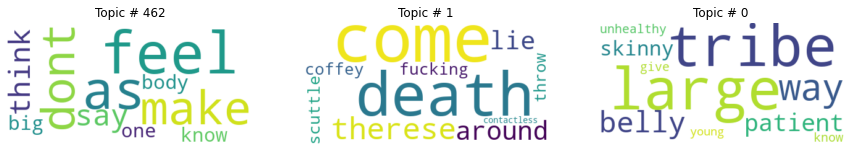

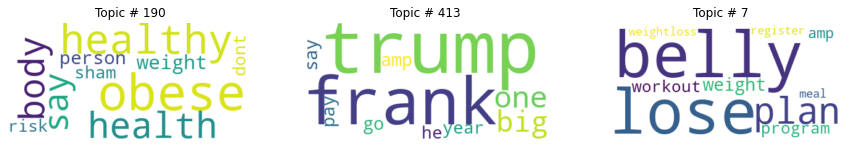

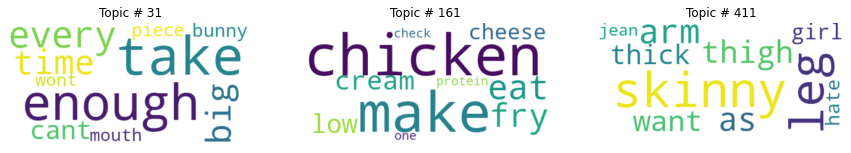

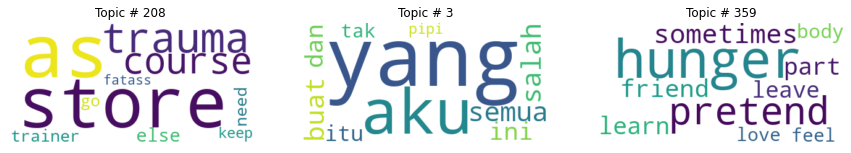

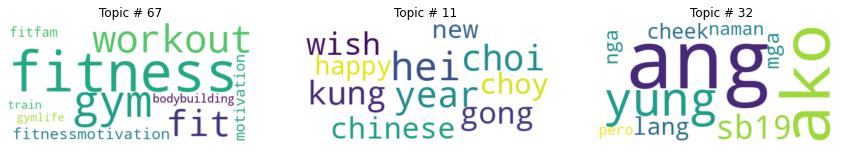

...

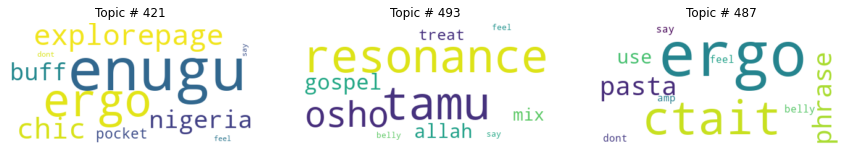

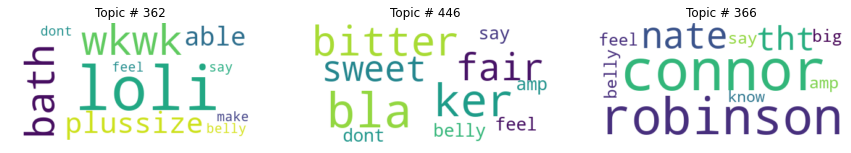

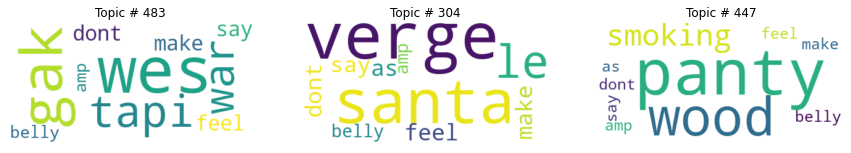

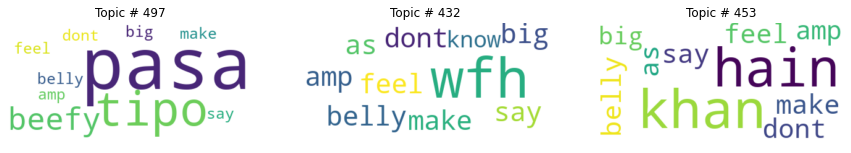

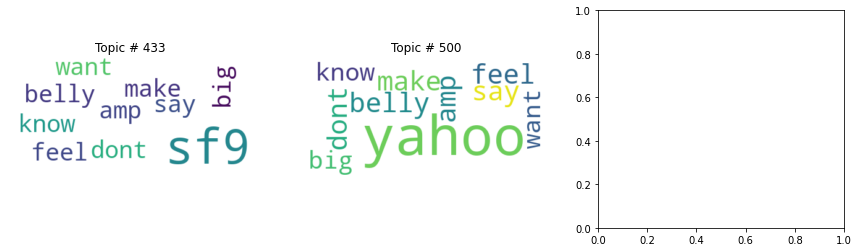

In [63]:
hdp_topics_to_wordclouds(hdp, hdp_topics)

C:\Users\bkarna\AppData\Local\Temp/ipykernel_26048/3170681549.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 3, figsize=(15,4))


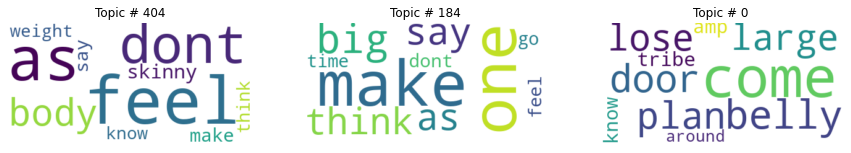

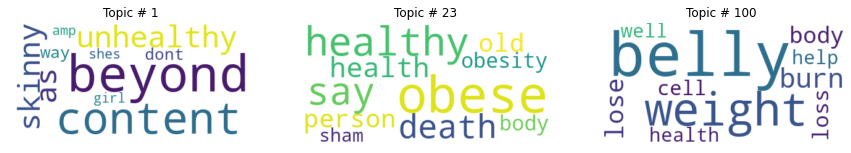

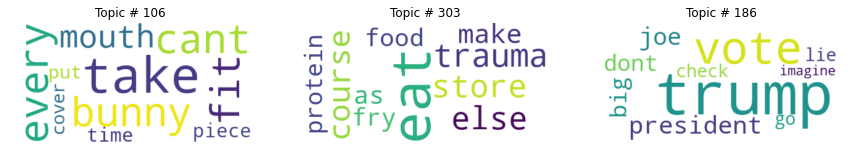

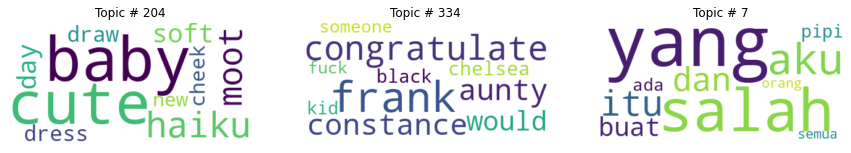

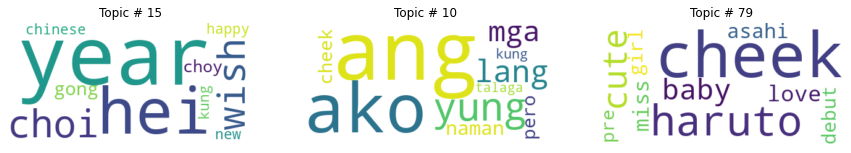

...

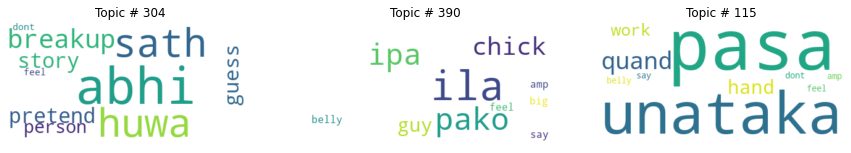

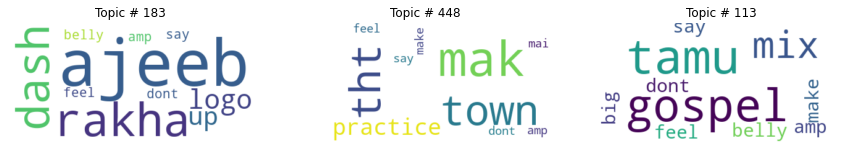

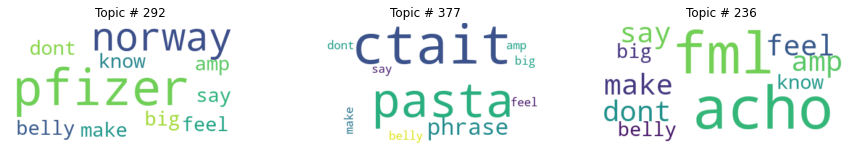

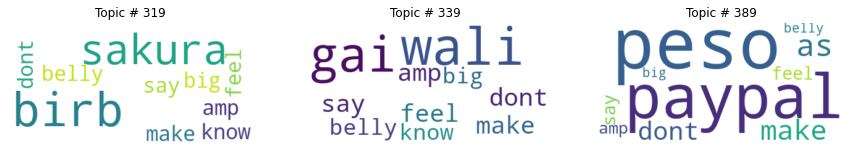

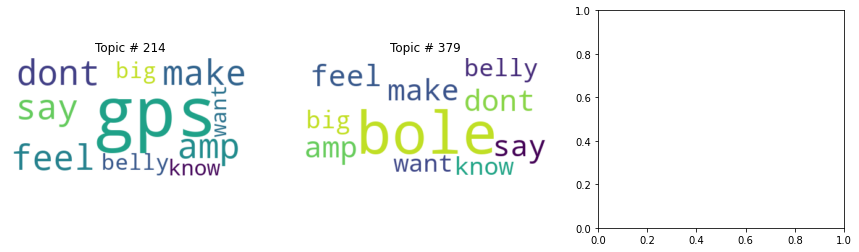

In [64]:
hdp_topics_to_wordclouds(hdp_NoHASH, hdp_topics_NoHASH)

## Labeled output with top words for the HDP Topic Modeling

== Topic #0 ==
Labels: fat, , people, know, amp
large	0.007058430928736925
tribe	0.007030984852463007
way	0.006313919555395842
belly	0.00584790064021945
patient	0.005513821728527546
skinny	0.005456006620079279
unhealthy	0.005394408944994211
know	0.005390380509197712
give	0.005351676139980555
young	0.004991685505956411

== Topic #1 ==
Labels: fat, like, amp, get, say
come	0.009641005657613277
death	0.0075859129428863525
therese	0.005947122350335121
around	0.0059330337680876255
lie	0.005735911428928375
fucking	0.005602845922112465
throw	0.005507727153599262
coffey	0.005490293726325035
scuttle	0.005482255481183529
contactless	0.005477835889905691

== Topic #2 ==
Labels: pra, que, uma, tem, com
que	0.042015016078948975
pra	0.021741732954978943
uma	0.015208755619823933
com	0.0148550970479846
tem	0.01412735041230917
ma	0.01340477168560028
ele	0.012577254325151443
isso	0.010035587474703789
para	0.010003766044974327
por	0.009600536897778511

== Topic #3 ==
Labels: yang, buat, ini, dan, itu
yan

jualan	0.01666935533285141

== Topic #28 ==
Labels: hatt, rakha, mann, sahi, pehle
kar	0.04978596419095993
reload	0.04875144362449646
pehle	0.02973153628408909
maarne	0.028814272955060005
joote	0.028814272955060005
chutiyapa	0.028814272955060005
khajwa	0.028814272955060005
kharach	0.028814272955060005
saaale	0.028814272955060005
gale	0.02844000980257988

== Topic #29 ==
Labels: gre, auf, mich, jetzt, hab
haarfarbe	0.03172200173139572
augenfarbe	0.03172200173139572
wohnort	0.03172200173139572
haarlnge	0.03172200173139572
brillentrger	0.03172200173139572
jahre	0.03130997344851494
figur	0.030946537852287292
gre	0.028640901669859886
dtre	0.02759862318634987
alone	0.027537642046809196

== Topic #30 ==
Labels: bakugo, tamaki, esta, estar, aizawa
bien	0.09780419617891312
estar	0.08072967082262039
alden	0.048478420823812485
esta	0.037122469395399094
kaminari	0.03611326217651367
kay	0.031547557562589645
aldenrchards	0.030423352494835854
donde	0.029241204261779785
tawang	0.028934018686413765
taw

Labels: unprecedented, gin, rough, scott, nintendoswitch
rough	0.07261835783720016
nintendoswitch	0.06934293359518051
noirs	0.0556437149643898
unprecedented	0.05201157182455063
animalcrossing	0.05201157182455063
race	0.05037602409720421
gin	0.04625476896762848
scott	0.042891405522823334
shuuu	0.0371016301214695
win	0.03706369921565056

== Topic #56 ==
Labels: treasure, teumes, sma, kst, genie
treasure	0.09202311933040619
vote	0.043648410588502884
teumes	0.030105547979474068
sma	0.02185790240764618
gap	0.018289625644683838
stream	0.016902929171919823
collect	0.01595054380595684
kst	0.015522239729762077
widen	0.010461694560945034
please	0.009936234913766384

== Topic #57 ==
Labels: carne, snk, aave, holland, tweek
hewe	0.11054546386003494
thicc	0.10499698668718338
carne	0.08904391527175903
choclo	0.07324782013893127
lioness	0.051956791430711746
madi	0.0381685234606266
still	0.02220861427485943
nan	0.022127747535705566
boa	0.021792838349938393
mme	0.02132146805524826

== Topic #58 ==
Labe

Labels: kama, hii, ndio, kwa, gari
kwa	0.052375201135873795
hii	0.03624763339757919
kama	0.03146214038133621
ndio	0.031260404735803604
mwingine	0.023557184264063835
nguo	0.023557184264063835
siku	0.023557184264063835
hapo	0.022514434531331062
ata	0.020595354959368706
kuna	0.018081465736031532

== Topic #85 ==
Labels: chubbytummies, hamayya malli chubby ayyaru, malli chubby ayyaru sarkaruvaaripaata, hamayya, hamayya malli chubby ayyaru sarkaruvaaripaata
chubbytummies	0.48714014887809753
pornlib	0.054509732872247696
fatima	0.03726635500788689
sarkaruvaaripaata	0.03363583981990814
ps4share	0.03001442365348339
malli	0.026311660185456276
eewa	0.025924989953637123
ayyaru	0.021543212234973907
hamayya	0.021543212234973907
vunnav	0.019924497231841087

== Topic #86 ==
Labels: anxietyrelief, boudoir, chubbygirl, psychology, mindfulness
anxietyrelief	0.04881541058421135
chubbylove	0.031647633761167526
boudoirphotos	0.031647633761167526
boudoirshoot	0.031647633761167526
boudoirinspiration	0.0316476

Labels: peha, kecik, pasal, betul, pon
peha	0.10998908430337906
nak	0.08019009977579117
soalan	0.05499793961644173
kecikkan	0.05499793961644173
payah	0.05435953289270401
kecik	0.05327184870839119
byk	0.052872125059366226
betul	0.05003144592046738
pon	0.05003144219517708
pasal	0.05003144219517708

== Topic #115 ==
Labels: keepwarm, fashionista, keepfit, newyearnewme, fashion
keepwarm	0.022220194339752197
fashion	0.02054121159017086
check	0.020225029438734055
size	0.019105948507785797
woman	0.017528975382447243
keepfit	0.016884539276361465
golf	0.015600189566612244
bodywarmer	0.01371596846729517
exercise	0.013521230779588223
newyearnewme	0.011819463223218918

== Topic #116 ==
Labels: u_know, tvxq, teaser, noir, thanku
noir	0.14413848519325256
thanku	0.07037179917097092
u_know	0.0680915042757988
album	0.0679008960723877
tvxq	0.06052662804722786
kst	0.059114206582307816
mini	0.05098405480384827
teaser	0.03449469804763794
know	0.02469656430184841
naver	0.024287622421979904

== Topic #117 ==

ben	0.058113664388656616
tom	0.051193203777074814
end	0.036421578377485275
kathniel	0.031872112303972244
ice	0.028670351952314377
cream	0.0271424762904644
allah	0.02549043297767639
pretzel	0.025021681562066078

== Topic #145 ==
Labels: decoration, motorcycle, davidson, biker, harley
ornament	0.06384073197841644
tinytan	0.059864502400159836
figure	0.03597730025649071
interior	0.029497280716896057
decor	0.029497280716896057
decoration	0.028474247083067894
motorcycle	0.028200874105095863
davidson	0.027721725404262543
biker	0.027721721678972244
harley	0.02678832784295082

== Topic #146 ==
Labels: refund, arrow, sling, nadech, f4t
freddys	0.07865392416715622
refund	0.04962599277496338
drop	0.04194331914186478
dming	0.039336223155260086
bag	0.03548789024353027
moon	0.028672298416495323
credit	0.02427177131175995
bone	0.02250097692012787
iyi	0.01967737264931202
bole	0.01967737264931202

== Topic #147 ==
Labels: aga, junsu, wala, kha, mata
kho	0.08895981311798096
iphone	0.06295441836118698
tut

anydesk	0.043631985783576965
non	0.035332877188920975
borderline	0.034475892782211304
oso	0.02918621152639389
cubby	0.028650103136897087

== Topic #176 ==
Labels: o1o, 2914, 9801, tk567, o1o 2914 9801 tk567
o1o	0.08328696340322495
9801	0.06119125708937645
tk567	0.06119125708937645
2914	0.06119125708937645
jm5969	0.0338866300880909
6835	0.0338866300880909
5969	0.0338866300880909
lone	0.02112000063061714
conform	0.010677394457161427
theater	0.0105653190985322

== Topic #177 ==
Labels: winnie, pooh, cubby, willy, fluff
winnie	0.09751836210489273
pooh	0.09070716798305511
cubby	0.06382330507040024
fluff	0.04220820218324661
grrrr	0.03478742018342018
nut	0.03241308405995369
little	0.03050719015300274
stomp	0.029387272894382477
stuff	0.026980260387063026
gaybeard	0.01740190014243126

== Topic #178 ==
Labels: gengar, cozy, transmascs, request, husband
gengar	0.1975070983171463
transmascs	0.10434017330408096
cozy	0.09278924763202667
request	0.07338203489780426
husband	0.06534672528505325
pull	0.

reasonable	0.05176457762718201
logo	0.04959012195467949
asap	0.04061567410826683
designer	0.03560104966163635
gym	0.035200826823711395
developer	0.034502848982810974

== Topic #210 ==
Labels: indiedev, wizard, pilot, hobo, befriend
gamedevideas	0.10044926404953003
indiedev	0.09696432948112488
game	0.05267803370952606
idea	0.05095812305808067
forsake	0.03458979353308678
wizard	0.029348058626055717
befriend	0.028346620500087738
elderly	0.024106325581669807
life	0.019081683829426765
drink	0.017098307609558105

== Topic #211 ==
Labels: mene, rada, pista, sayeth, iski
mene	0.09647123515605927
ovo	0.05161650851368904
ako	0.05085602030158043
bog	0.04933226481080055
mama	0.03079133853316307
tek	0.025820404291152954
npr	0.025820404291152954
mali	0.025377357378602028
lia	0.025002766400575638
kardo	0.02439206652343273

== Topic #212 ==
Labels: burn, workout, exercise, belly, cardio
belly	0.07268090546131134
burn	0.04979658126831055
exercise	0.047997426241636276
workout	0.044485870748758316
best	0

postage	0.045697808265686035
pet	0.043147891759872437
exclude	0.039642781019210815
jhope	0.034914109855890274
lt3	0.028995078057050705
bts	0.023723050951957703
cooky	0.022951669991016388

== Topic #239 ==
Labels: vanessa, nationwide, deer, patronize, raila
minna	0.054256509989500046
tiwariana	0.04866494983434677
mimsie	0.04866494983434677
homewells	0.04866494983434677
vanessa	0.04303380474448204
panda	0.04257380962371826
deer	0.0421026274561882
patronize	0.03835955262184143
smart	0.03486984595656395
delivery	0.03179680183529854

== Topic #240 ==
Labels: cia, rehabilitate, fund, mike, career
psy	0.11874785274267197
mike	0.10934227705001831
cia	0.10929334908723831
rehabilitate	0.10763852298259735
fund	0.08954732120037079
career	0.0791073590517044
account	0.0649123266339302
bby	1.6917816537898034e-05
make	1.6914589650696144e-05
dont	1.6914589650696144e-05

== Topic #241 ==
Labels: abstract, malnutrition, conference, abc, printable
diet	0.04602079838514328
weightloss	0.044755350798368454
s

whilst	0.03920216113328934
slang	0.03584890812635422
california	0.03034597635269165
finger	0.028697429224848747

== Topic #268 ==
Labels: proposal, blank, saba, kayserisex, pratchett
flap	0.07337236404418945
l3am	0.07255556434392929
akong	0.033730875700712204
mai	0.03182171657681465
hhhh	0.02843286469578743
diay	0.027532078325748444
rah	0.02717459201812744
blank	0.024347376078367233
wala	0.021367698907852173
nga	0.020607125014066696

== Topic #269 ==
Labels: creo, checker, elvis, workoutathome, simon
checker	0.06161538138985634
legend	0.04073408246040344
twist	0.03461901843547821
que	0.031027181074023247
warm	0.02366233617067337
carly	0.0190715454518795
kenai	0.018744301050901413
nuestros	0.018227947875857353
hottie	0.018016541376709938
creo	0.017656361684203148

== Topic #270 ==
Labels: fee moghel eribaby look, ppl fee moghel eribaby look, fee moghel eribaby look chubby, eribaby look chubby ghana elite, ghana ppl fee moghel eribaby
ghana	0.25259634852409363
eribaby	0.13771158456802368

route	0.036982495337724686

== Topic #298 ==
Labels: priti, kayak, mutluluk, azdm, kayserisex
priti	0.07836781442165375
alma	0.04149908944964409
paz	0.04018496349453926
kayak	0.03671951964497566
mochi	0.03199438378214836
pipinya	0.029054492712020874
feel	3.905592529918067e-05
say	3.905592529918067e-05
belly	3.905592529918067e-05
amp	3.905592529918067e-05

== Topic #299 ==
Labels: nctdream, ndi, jisung, nine, dmg
nctdream	0.0731399729847908
jisung	0.06802278757095337
meow	0.06605064123868942
ndi	0.06423085927963257
ala	0.05906364321708679
call	0.05201419070363045
fight	0.04596509784460068
dream	0.041611313819885254
chuang2019	0.03669865429401398
rooftop	0.029360327869653702

== Topic #300 ==
Labels: yakuza, voor, gang, isolate, beth
esns21	0.11782468855381012
gang	0.1061423122882843
yakuza	0.025495827198028564
voor	0.02512538991868496
dit	0.0238505732268095
isolate	0.023639775812625885
youth	0.022492488846182823
rule	0.018270662054419518
society	0.01694490574300289
moment	0.016723785549

Labels: zombie, apocalypse, carpet, luxury, cvsvape
pant	0.09319277852773666
zombie	0.09090567380189896
plain	0.052929993718862534
update	0.04042220115661621
promote	0.03923558443784714
fitness	0.030011245980858803
wristwatch	0.02764885313808918
apocalypse	0.02516133524477482
luxury	0.022898942232131958
set	0.022784648463129997

== Topic #330 ==
Labels: skunk, hash, wheat, jam, goodnight
goodnight	0.15976582467556
animal	0.03906414285302162
skunk	0.03855178505182266
hash	0.03801504150032997
jam	0.03343496099114418
dam	0.029751835390925407
cash	0.02944248355925083
jump	0.026870327070355415
teal	0.020988844335079193
cat	0.01923680678009987

== Topic #331 ==
Labels: bonnie, chica, freddy, toy, pastry
bonnie	0.1259826272726059
toy	0.060086168348789215
xbox	0.051597464829683304
download	0.03507855907082558
last	0.03400705009698868
comply	0.03197941184043884
chica	0.029610607773065567
game	0.02478429116308689
shadow	0.024496840313076973
one	0.023689860478043556

== Topic #332 ==
Labels: gany

moth	0.09334242343902588
gamer	0.07486550509929657
tortoise	0.06607577949762344
brighten	0.05375783517956734
timeline	0.05052421987056732
little	0.03538743406534195
leg	0.024642610922455788
fuck	3.165838643326424e-05
yoh	3.1656880310038105e-05
sharma	3.1656880310038105e-05

== Topic #359 ==
Labels: fat, get, like, look, say
hunger	0.023364471271634102
pretend	0.010839768685400486
sometimes	0.009713426232337952
friend	0.009333662688732147
learn	0.009255503304302692
part	0.009215384721755981
leave	0.009197183884680271
body	0.008778516203165054
love	0.007667498663067818
feel	0.007618471514433622

== Topic #360 ==
Labels: chow, yun, pak, chuuya, f4t
chow	0.0892244353890419
yun	0.08250204473733902
kirishima	0.06410021334886551
agenda	0.06100551411509514
spread	0.049367547035217285
cheek	0.042738962918519974
sadar	0.032424457371234894
man	0.029526691883802414
baru	0.02381080947816372
god	0.022648144513368607

== Topic #361 ==
Labels: anitwtselfieday, anisd, brrrr, woozi, seventeen
anitwtselc

Labels: supportsmallbusiness, supportlocal, shoplocal, appt, chad
fitness1gym35ave	0.07192745059728622
supportfamily	0.07192745059728622
locallyownedandoperated	0.07192745059728622
supportsmallbusiness	0.06723180413246155
supportlocal	0.06545444577932358
gym	0.03741120547056198
shoplocal	0.037139713764190674
fitfam	0.026978351175785065
appt	0.026642583310604095
fitness	0.0249931700527668

== Topic #391 ==
Labels: inka, berserk, nae, touya, f4t
ntr	0.06618501991033554
jai	0.049550823867321014
edo	0.038898494094610214
sri	0.03823062404990196
nae	0.0360102616250515
keerthy	0.03382030129432678
hit	0.02644323743879795
glow	0.025592828169465065
shoot	0.02348518930375576
bullet	0.021818052977323532

== Topic #392 ==
Labels: cbd, hemp, gummies, cannabis, investor
cbd	0.06250029802322388
hemp	0.038799647241830826
gummies	0.03633774816989899
stock	0.03204287588596344
tablet	0.02690110355615616
loss	0.02343003638088703
weight	0.022184139117598534
tri	0.02132325805723667
monday	0.0212725717574358


Labels: iin, wittle, cuff, stubby, llama
oldu	0.0587766058743
wittle	0.05361706763505936
hasta	0.05228598788380623
son	0.031127773225307465
olduu	0.030543947592377663
baya	0.029915697872638702
iin	0.02796417661011219
cuff	0.026640906929969788
stubby	0.02647021971642971
ohmy	0.02392377145588398

== Topic #431 ==
Labels: 2021goals, gethealthy, archive, anxietyrelief, airdrop
drinkmorewater	0.10549040883779526
followus	0.10549040883779526
weightloss	0.04471585154533386
wangyibo	0.026391232386231422
nadler	0.02593839168548584
archive	0.024432899430394173
srsly	0.024017978459596634
desperately	0.021353816613554955
pada	0.02093387395143509
titan	0.019872209057211876

== Topic #432 ==
Labels: mutluluk, azdm, kayserisex, agave, scaphiophryne
wfh	0.08855750411748886
as	4.795050699613057e-05
make	4.795050699613057e-05
dont	4.795050699613057e-05
feel	4.795050699613057e-05
say	4.795050699613057e-05
belly	4.795050699613057e-05
amp	4.795050699613057e-05
big	4.795050699613057e-05
know	4.7950506996130

ghost	0.02995286136865616
co	0.02510513737797737
lmao	0.019431566819548607
maybe	0.018524345010519028
well	0.01246640831232071

== Topic #460 ==
Labels: azdm, mutluluk, kayserisex, agave, scaphiophryne
as	5.260666148387827e-05
make	5.260666148387827e-05
dont	5.260666148387827e-05
feel	5.260666148387827e-05
say	5.260666148387827e-05
belly	5.260666148387827e-05
amp	5.260666148387827e-05
big	5.260666148387827e-05
know	5.260666148387827e-05
want	5.260666148387827e-05

== Topic #461 ==
Labels: coverage, behemoth, alert, david, sam
aka	0.09582489728927612
berkowitz	0.05948029085993767
straightupevil	0.05948029085993767
blondebrunetteredhead	0.05948029085993767
truecrime	0.05948029085993767
truecrimepodcast	0.05948029085993767
bestfriends	0.05860160291194916
coverage	0.052339378744363785
behemoth	0.050906844437122345
alert	0.04674851894378662

== Topic #462 ==
Labels: like, make, get, dont, feel
feel	0.006305998656898737
as	0.0052722664549946785
make	0.004981691017746925
dont	0.00488597992807

ufc257	0.02384982816874981
khabib	0.02349778451025486
dustin	0.02349778451025486
mboli	0.02319283038377762

== Topic #486 ==
Labels: jesse, bryan, williams, dua, hype
jesse	0.054792370647192
williams	0.053615033626556396
hype	0.04407928138971329
pompeo	0.029178868979215622
guy	0.021875325590372086
godt	0.02050442434847355
sm4	0.02050442434847355
nunggu	0.02008267492055893
hurdle	0.02008267492055893
diyor	0.02008267492055893

== Topic #487 ==
Labels: sayeth, nadech, mutluluk, azdm, kayserisex
ergo	0.08442070335149765
ctait	0.04342745617032051
pasta	0.033094145357608795
phrase	0.032924387603998184
use	0.015865208581089973
dont	4.158429874223657e-05
feel	4.158429874223657e-05
say	4.158429874223657e-05
belly	4.158429874223657e-05
amp	4.158429874223657e-05

== Topic #488 ==
Labels: scaphiophryne, agave, dmg, corvette, mutluluk
wkwk	0.05210122466087341
nag	0.04986812174320221
kog	0.031109103932976723
nakog	0.031109103932976723
uksnow	0.030575308948755264
tembem	0.029733043164014816
nako	0.02

want	5.260666148387827e-05

== Topic #513 ==
Labels: azdm, mutluluk, kayserisex, agave, scaphiophryne
as	5.260666148387827e-05
make	5.260666148387827e-05
dont	5.260666148387827e-05
feel	5.260666148387827e-05
say	5.260666148387827e-05
belly	5.260666148387827e-05
amp	5.260666148387827e-05
big	5.260666148387827e-05
know	5.260666148387827e-05
want	5.260666148387827e-05



In [66]:
# extract candidates for auto topic labeling
extractor = tp.label.PMIExtractor(min_cf=10, min_df=5, max_len=5, max_cand=10000)
cands = extractor.extract(hdp_NoHASH)

# ranking the candidates of labels for a specific topic
labeler = tp.label.FoRelevance(hdp_NoHASH, cands, min_df=5, smoothing=1e-2, mu=0.25)
for k in range(hdp_NoHASH.k):
    print("== Topic #{} ==".format(k))
    print("Labels:", ', '.join(label for label, score in labeler.get_topic_labels(k, top_n=5)))
    for word, prob in hdp_NoHASH.get_topic_words(k, top_n=10):
        print(word, prob, sep='\t')
    print()

== Topic #0 ==
Labels: fat, amp, like, look, see
come	0.00855217594653368
belly	0.007831297814846039
door	0.007386300712823868
plan	0.006855707615613937
lose	0.00653418991714716
large	0.006329795811325312
tribe	0.006293108221143484
amp	0.006066155154258013
know	0.006023388355970383
around	0.005500916391611099

== Topic #1 ==
Labels: fat, people, , make, amp
beyond	0.006512116640806198
content	0.006461978890001774
unhealthy	0.006247729994356632
skinny	0.006204009521752596
as	0.006113553419709206
way	0.00566032575443387
dont	0.0053331442177295685
girl	0.005189437419176102
shes	0.005173567216843367
amp	0.005088552366942167

== Topic #2 ==
Labels: ont, il, fait, trop, de
dtre	0.04769638180732727
pour	0.03801681473851204
alone	0.0367288663983345
abeg	0.033863335847854614
vous	0.02881581336259842
leave	0.026993274688720703
avant	0.026506435126066208
de	0.026445604860782623
que	0.02633734606206417
ont	0.025044694542884827

== Topic #3 ==
Labels: pra, que, uma, tem, com
que	0.04240143299102783

Labels: denver, rout, oak, barbara, route
la	0.1055733785033226
sba	0.06817051768302917
oakland	0.06676723062992096
denver	0.06307079643011093
den	0.06030036881566048
vega	0.05054095759987831
oak	0.031209351494908333
rout	0.031209351494908333
barbara	0.031209351494908333
route	0.028456561267375946

== Topic #36 ==
Labels: rip right start tear middle, start tear middle first thigh, middle first thigh rubbing together, tear middle first thigh rubbing, right start tear middle first
bye	0.29282498359680176
playstation	0.03788163512945175
jati	0.03339635580778122
offline	0.02997274324297905
pfc	0.028849981725215912
comel	0.02649773843586445
oki	0.022211778908967972
tomorrow	0.02029106393456459
together	0.019641859456896782
night	0.018601614981889725

== Topic #37 ==
Labels: tak, mcm, kena, sebab, tahu
aku	0.04608827456831932
tak	0.038714706897735596
nmpk	0.030795425176620483
cuba	0.030794192105531693
adalah	0.029711447656154633
tag	0.02964376099407673
byk	0.029511163011193275
kena	0.0289725

kahi	0.04534681886434555
bus	0.04468182474374771
jana	0.04353509843349457
conduct	0.0422496534883976
bsf	0.03163624554872513
rhe	0.029571468010544777
mar	0.023817766457796097

== Topic #61 ==
Labels: kylo, ren, hound, widen, f4t
kylo	0.09450696408748627
anaa	0.07993925362825394
ad3n	0.06507183611392975
wop3	0.06507183611392975
ren	0.045183632522821426
moti	0.040889155119657516
hux	0.03254358470439911
chubbyrey	0.031512536108493805
threesome	0.03074243851006031
emperor	0.02548782154917717

== Topic #62 ==
Labels: ale, jak, nie, sie, korang
ape	0.0861753299832344
jak	0.08249413967132568
nie	0.0682324767112732
tak	0.06575315445661545
ale	0.05249927192926407
bagger	0.051140327006578445
jest	0.0414433553814888
bichectomy	0.03636102005839348
mnie	0.03359261155128479
sie	0.023875687271356583

== Topic #63 ==
Labels: chubby otter grappling technique, grappling, youtube, otter, livin
youtube	0.11675813049077988
otter	0.11309102177619934
grappling	0.11153405904769897
vol2	0.08374693244695663
joe

Labels: chubby boy band mission become, meet produce panda china, produce panda china chubby boy, china chubby boy band mission, panda china chubby boy band
boy	0.1441703587770462
cherry	0.13083957135677338
cute	0.0906713530421257
band	0.07697399705648422
panda	0.05515506863594055
produce	0.04790988564491272
china	0.04003731906414032
365	0.037069711834192276
mission	0.030612822622060776
meet	0.02726886421442032

== Topic #94 ==
Labels: vanilla, imperial, slobber, swirl, cocktail
lyra	0.17889896035194397
vanilla	0.15139631927013397
nowplaying	0.14908729493618011
radio	0.022070588544011116
che	2.9019542125752196e-05
____	2.900847903219983e-05
diam	2.900847903219983e-05
porta	2.900847903219983e-05
michael	2.9005712349317037e-05
pulse	2.9005712349317037e-05

== Topic #95 ==
Labels: moses, filet, tender, lobster, tooo
kuria	0.05628923326730728
tender	0.03425891324877739
moses	0.030443334951996803
tanga	0.02193969488143921
plaza	0.02148820459842682
mignon	0.0208074152469635
siphon	0.02080741

sub	0.1253572255373001
cheek	0.11217818409204483
eye	0.11052567511796951
sunoo	0.023571372032165527
obsess	0.018808303400874138
jinkis	0.018502866849303246
discharge	0.01670853979885578
hoshi	0.014548804610967636

== Topic #127 ==
Labels: maricn, ateo, sayeth, mutluluk, agave
ateo	0.40116414427757263
maricn	0.40116414427757263
cnt	0.011507634073495865
grooveoverdrive	1.083556253433926e-05
chubbytummies	1.0832464795385022e-05
laka	1.0832464795385022e-05
wfh	1.0832464795385022e-05
sublime	1.0832464795385022e-05
ello	1.0832464795385022e-05
nimra	1.0832464795385022e-05

== Topic #128 ==
Labels: jeetegi, rubina, toh, bubby, mahajan
jeetegi	0.11759742349386215
rubina	0.1141214668750763
toh	0.11247789859771729
rahul	0.053172625601291656
bubby	0.04906034469604492
rubby	0.03023143857717514
thank	0.019874371588230133
amaze	0.019036278128623962
trio	0.01848609186708927
abhinav	0.018310749903321266

== Topic #129 ==
Labels: removal, laser, technology, fat freeze fat dissolve injection, bond etc co

Labels: azul, nintendo, gratis, creo, wii
negra	0.058514304459095
nintendo	0.04593093693256378
gratis	0.04313720390200615
precio	0.03969423472881317
switch202000100	0.03969423472881317
azul	0.03749682009220123
nen	0.029261814430356026
roja	0.029261814430356026
con	0.025024710223078728
accident	0.023490412160754204

== Topic #161 ==
Labels: marina, lesbian, sexuality time apology sorry yall, hear people uncomfortable talk sexuality, lesbian yall idea lesbian lesbian
marina	0.46894562244415283
lesbian	0.4504358470439911
interracial	0.009395897388458252
alt	0.004586704075336456
stan	0.004540542606264353
akhir	0.0031997482292354107
tutu	0.003080156398937106
sab	0.002605453133583069
sweetheart	0.0025280688423663378
eii	2.9590607937279856e-06

== Topic #162 ==
Labels: kurangkan, produk, timbang, tingkat, luar
buat	0.04471873864531517
exercise	0.034296613186597824
urrghh	0.03393098711967468
intensiti	0.03393098711967468
bazir	0.03393098711967468
kawalan	0.03393098711967468
kurangkan	0.0335745

sneak	0.0506136491894722
boleyn	0.0499131977558136
behead	0.049175892025232315
clap	0.04892852529883385
viii	0.045860547572374344
cake	0.04571143165230751
treason	0.04553055390715599
anne	0.04439990594983101
henry	0.04038335382938385

== Topic #197 ==
Labels: inconvenience, thickness, commendable, submissive, jobless
bottom	0.08261717855930328
sorry	0.07568954676389694
chonks	0.061924129724502563
gettin	0.05563908815383911
girl	0.05372365936636925
plus	0.04211677238345146
believe	0.040685057640075684
portrait	0.03230791166424751
kind	0.030941270291805267
raymond	0.02435130439698696

== Topic #198 ==
Labels: jasmine, bilkul, aaj, tumhari, newborn
hai	0.06985362619161606
rubena	0.04604650288820267
momos	0.04254145920276642
jasmine	0.04150184243917465
bilkul	0.04150184243917465
mubarak	0.039674095809459686
tumhari	0.039674095809459686
ali	0.025183213874697685
newborn	0.020346201956272125
aaj	0.020000671967864037

== Topic #199 ==
Labels: ook, een, niet, maar, voor
dit	0.04199542850255966


== Topic #226 ==
Labels: transmascs, lanky, ily, masculine, buff
transmascs	0.2608279287815094
masculine	0.07952290773391724
pull	0.06809995323419571
shirt	0.06473392248153687
lanky	0.04575515165925026
ily	0.0422108992934227
also	0.035984281450510025
buff	0.03560470789670944
proud	0.029921894893050194
great	0.022240260615944862

== Topic #227 ==
Labels: kuna, ndio, dame, gari, mat
hapo	0.07530053704977036
kuna	0.06047513335943222
mwingine	0.05253348499536514
uku	0.026279106736183167
flappy	0.025446925312280655
mtu	0.025446925312280655
inshaallah	0.02511666715145111
lakini	0.02511666715145111
dame	0.023561956360936165
ndio	0.023252395913004875

== Topic #228 ==
Labels: ashanti, speaker, luv, pen, feat
luv	0.05861619859933853
ashanti	0.05662528797984123
upmc	0.05228959396481514
lemieux	0.05228959396481514
blare	0.051011305302381516
whats	0.047453831881284714
feat	0.04427703097462654
speaker	0.043056290596723557
pen	0.040650900453329086
complex	0.0370885469019413

== Topic #229 ==
Labels:

mashallah	0.05843981355428696
bog	0.04326416552066803
aga	0.04231289401650429
der	0.03460406884551048
lia	0.029227014631032944
mama	0.0270007885992527
avi	0.024652937427163124
kay	0.023074116557836533

== Topic #266 ==
Labels: eat pizza eat tub ice, ice cream eat entire family, eat tub ice cream eat, pizza eat tub ice cream, tub ice cream eat entire
eat	0.1113397479057312
yolo	0.07143056392669678
ice	0.07035317271947861
pizza	0.06922125816345215
cream	0.06706010550260544
entire	0.055309999734163284
hubby	0.05412992089986801
tub	0.0500006340444088
ben	0.0487632229924202
jerry	0.048413828015327454

== Topic #267 ==
Labels: youthful, energetic, repeat, organize, dedicate
youthful	0.09646786004304886
repeat	0.08057715743780136
easy	0.05740068480372429
agile	0.05680849775671959
energetic	0.05383032560348511
dedicate	0.04605656489729881
assertive	0.04400418698787689
successful	0.04334798455238342
nimble	0.04324863851070404
organize	0.037503764033317566

== Topic #268 ==
Labels: zulu, partial

Labels: smooch, hitman, corvette, mwah, cartman
automaticaiiy	0.09820485860109329
adorabie	0.09820485860109329
cuddie	0.09820485860109329
ruies	0.09820485860109329
ioi	0.09651847183704376
smooch	0.07328088581562042
youre	0.068790502846241
dont	0.025603938847780228
make	0.025110075250267982
lazy	1.850253829616122e-05

== Topic #295 ==
Labels: manual, lagos, repair, machine, thier
machine	0.0735553428530693
tel	0.06993473321199417
solve	0.06089551001787186
wash	0.04982366785407066
manufacturer	0.04196641966700554
signature	0.03906647488474846
problem	0.032385699450969696
service	0.029623277485370636
kind	0.029596220701932907
innovation	0.028683217242360115

== Topic #296 ==
Labels: pussy, gyal, succulent, zayn pussy would breathtaking would, yuh
pussy	0.36863699555397034
good	0.07499050348997116
gyal	0.03015349991619587
succulent	0.029922228306531906
evening	0.029850007966160774
spliff	0.023753434419631958
bout	0.02000434696674347
bully	0.017998363822698593
munda	0.01657160371541977
sick

Labels: gitu, kayak, aneh, aja, mungkin
pok	0.056619640439748764
gitu	0.0386989526450634
wkwkwk	0.033024512231349945
tuh	0.03084477037191391
suka	0.02849406749010086
aja	0.02825387381017208
makin	0.025860311463475227
ssy	0.025241119787096977
bukannya	0.025241119787096977
priti	0.024624282494187355

== Topic #334 ==
Labels: would, fat, get, one, say
frank	0.012840738520026207
congratulate	0.01045131403952837
constance	0.007844650186598301
aunty	0.007795830722898245
would	0.006790713872760534
chelsea	0.006694856099784374
black	0.006453194189816713
kid	0.006043863017112017
someone	0.005687137134373188
fuck	0.005448413547128439

== Topic #335 ==
Labels: commission astra116 chubby night elf, astra116, elf, commission, night
astra116	0.23443782329559326
elf	0.22423312067985535
commission	0.19291523098945618
night	0.18943798542022705
hope	0.017635434865951538
amin	0.007151470985263586
good	0.0067751347087323666
late	0.006404461804777384
sublime	7.043445748422528e-06
wwwwww	7.043445748422528e-

sentir	0.017865333706140518
dual	0.017865333706140518
negra	0.017865333706140518
tryin	0.017865333706140518
familia	0.0176016204059124

== Topic #359 ==
Labels: armin, bon, premier, centre, minister
laschet	0.09530201554298401
premier	0.0721094086766243
cdu	0.0454707108438015
centrist	0.0454707108438015
merkel	0.0454707108438015
chancellor	0.04468998312950134
kohl	0.04468998312950134
heir	0.044029880315065384
armin	0.0379432812333107
bon	0.03779811039566994

== Topic #360 ==
Labels: maka, ice, imperial, swirl, tmr
ice	0.06875092536211014
cream	0.04681356996297836
non	0.03553643450140953
allah	0.03275246173143387
whip	0.03145896643400192
zan	0.03140540421009064
milk	0.02870909869670868
mammal	0.026646126061677933
furry	0.02240242250263691
white	0.020972272381186485

== Topic #361 ==
Labels: jenner, kendall, na, parte, hala
kendall	0.06838644295930862
ben	0.05704987421631813
jenner	0.052249886095523834
yani	0.03979289159178734
na	0.03520296514034271
duro	0.02067885547876358
usb	0.0199059

Labels: fire, calorie, set, vlog, basta
set	0.07534528523683548
fire	0.07440599054098129
calorie	0.07238487899303436
burn	0.059721820056438446
kid	0.049499426037073135
lot	0.04887852072715759
decide	0.03815612196922302
depend	0.0366859957575798
douchebags	0.03429638221859932
today	0.03189002349972725

== Topic #385 ==
Labels: civilian, tactically, berserk, danganronpa, chiaki
embodiment	0.024701207876205444
initiate	0.024701207876205444
reactionary	0.024277355521917343
nagito	0.023918993771076202
liberate	0.02360856533050537
collectively	0.02360856533050537
massacre	0.02360856533050537
inshallah	0.02360856533050537
miraculously	0.02360856533050537
civilian	0.022868240252137184

== Topic #386 ==
Labels: kila, mahali, meru, wewe, accent
mtu	0.05809944495558739
kila	0.053429052233695984
mingi	0.029499290511012077
____	0.029499290511012077
panga	0.029499290511012077
uko	0.029063846915960312
grapple	0.029063846915960312
wewe	0.0280563123524189
meru	0.027105847373604774
mahali	0.027105847373

Labels: imperial, stout, elvis, tap, gold
stout	0.10340023040771484
imperial	0.0712827742099762
elvis	0.04308463633060455
tap	0.037879880517721176
gold	0.035845886915922165
porter	0.02516905590891838
brewhouse	0.02405571937561035
pug	0.022006729617714882
black	0.021908191964030266
oatmeal	0.021659456193447113

== Topic #413 ==
Labels: azdm, mutluluk, agave, dmg, sayeth
as	5.816658813273534e-05
make	5.816658813273534e-05
dont	5.816658813273534e-05
feel	5.816658813273534e-05
say	5.816658813273534e-05
amp	5.816658813273534e-05
belly	5.816658813273534e-05
big	5.816658813273534e-05
know	5.816658813273534e-05
want	5.816658813273534e-05

== Topic #414 ==
Labels: dua, dpt, sikit, beli, chloe
kita	0.03572801873087883
workout	0.0344705730676651
pulak	0.026426784694194794
fuh	0.026426784694194794
rumah	0.026426784694194794
lami	0.026036694645881653
dua	0.024892911314964294
dpt	0.024672722443938255
jud	0.023944728076457977
burn	0.023417184129357338

== Topic #415 ==
Labels: oticket, secure, notion

Labels: azdm, mutluluk, agave, dmg, sayeth
as	5.8166584494756535e-05
make	5.8166584494756535e-05
dont	5.8166584494756535e-05
feel	5.8166584494756535e-05
say	5.8166584494756535e-05
amp	5.8166584494756535e-05
belly	5.8166584494756535e-05
big	5.8166584494756535e-05
know	5.8166584494756535e-05
want	5.8166584494756535e-05

== Topic #441 ==
Labels: azdm, mutluluk, agave, dmg, sayeth
as	5.816658813273534e-05
make	5.816658813273534e-05
dont	5.816658813273534e-05
feel	5.816658813273534e-05
say	5.816658813273534e-05
amp	5.816658813273534e-05
belly	5.816658813273534e-05
big	5.816658813273534e-05
know	5.816658813273534e-05
want	5.816658813273534e-05

== Topic #442 ==
Labels: azdm, mutluluk, agave, dmg, sayeth
kang	5.8177480241283774e-05
suffer	5.8171935961581767e-05
as	5.816638804390095e-05
make	5.816638804390095e-05
dont	5.816638804390095e-05
feel	5.816638804390095e-05
say	5.816638804390095e-05
amp	5.816638804390095e-05
belly	5.816638804390095e-05
big	5.816638804390095e-05

== Topic #443 ==
Label